<a href="https://colab.research.google.com/github/ra-eng/hello-world/blob/master/objDetecResnet.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import json
import torchvision
import torch
import torch.nn as nn
import torchvision.transforms as T
import os
import xml.etree.ElementTree as ET
from PIL import Image,ImageDraw
from IPython.display import display
from torchvision.models.detection import FasterRCNN
from torchvision.models.detection.rpn import AnchorGenerator
import numpy as np

from sklearn.model_selection import KFold

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
os.chdir('/content/drive/My Drive/dataset/ObjectDetection')
from mapeval import voc_eval

In [ ]:
class MyDataset():
    def __init__(self,transforms = None):
        self.data = []
        self.transforms = transforms
        self.target_names = ['blanck']
        self.htarget_names = {'blanck':0}
        self.read_json()

    def get_label_id(self,name):
        if name not in self.htarget_names:
            self.htarget_names[name] = len(self.target_names)
            self.target_names.append(name)
        return self.htarget_names[name]
        
    def read_json(self):
        with open('labels.json') as json_file:
            data = json.load(json_file)
            for h in data:
                if 'objects' in h['Label']:
                    file_url = h['Labeled Data']
                    file_name = 'Img'+os.sep+h['External ID']
                    objects = h['Label']['objects']
                    boxes = []
                    labels = []
                    for obj in objects:
                        labels.append(self.get_label_id(obj['value']))
                        x1 = int(obj['bbox']['left'])
                        y1 = int(obj['bbox']['top'])
                        x2 = x1 + int(obj['bbox']['width'])
                        y2 = y1 + int(obj['bbox']['height'])
                        bbox  = [x1,y1,x2,y2]
                        boxes.append(bbox)
                    h = {}
                    h['file_img'] = file_name
                    h['labels'] = labels
                    h['boxes']  = boxes
                    self.data.append(h)
    def __getitem__(self,i):
        img   = Image.open(self.data[i]['file_img']).convert("RGB")
        boxes = torch.tensor(self.data[i]['boxes'])
        if self.transforms != None:
            img,boxes = self.transforms(img,boxes)
        r = dict()
        r['boxes']   = boxes
        r['labels']  = torch.tensor(self.data[i]['labels'])
        return img,r
    def __len__(self):
        return len(self.data)   

In [ ]:
def resize(img,boxes,size):
    w, h = img.size
    ow, oh = size
    sw = float(ow) / w
    sh = float(oh) / h
    img = img.resize((ow,oh), Image.BILINEAR)
    boxes = boxes * torch.tensor([sw,sh,sw,sh])
    return img, boxes

In [ ]:
size = (300,300)
def transform_data(img,boxes):
    img,boxes = resize(img,boxes,size)
    img = T.Compose([
          T.ToTensor(), 
          T.Normalize((0.485,0.456,0.406),(0.229,0.224,0.225))          
    ])(img)
    return img,boxes

In [ ]:
kf = KFold(n_splits=2, shuffle = True)

In [ ]:
data = MyDataset(transforms=transform_data)

In [ ]:
n = len(data)
n_treino = int(0.7*n)
n_teste  = n-n_treino

In [ ]:
n,n_treino,n_teste

(129, 90, 39)

In [ ]:
d_treino,d_teste = torch.utils.data.random_split(data,(n_treino,n_teste))

In [ ]:
d_treino

In [ ]:
def collate_fn(batch):
    return tuple(zip(*batch))
dl_treino = torch.utils.data.DataLoader(d_treino,batch_size = 8,collate_fn=collate_fn)
dl_teste  = torch.utils.data.DataLoader(d_teste,batch_size = 12,collate_fn=collate_fn)

In [ ]:
imgs,targets = next(iter(dl_treino))

In [ ]:
def draw_boxes(img,boxes,labels):
    imdraw = ImageDraw.Draw(img)
    for (box,label) in zip(boxes,labels):
        box = list(box)
        imdraw.rectangle(box,outline='red')
        text = "%d"%(label)
        imdraw.text((box[0],box[1]),text,fill='red')
    display(img)

In [ ]:
nview = T.ToPILImage()(imgs[0]*torch.Tensor([0.229,0.224,0.225]).view(3,1,1)+torch.Tensor([0.485,0.456,0.406]).view(3,1,1))

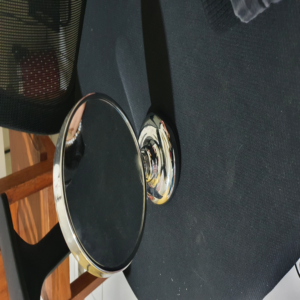

In [ ]:
nview

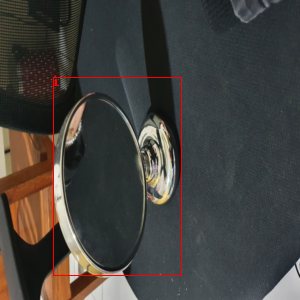

In [ ]:
draw_boxes(nview,targets[0]['boxes'],targets[0]['labels'])

# **Seleção mobilenet**

In [ ]:
# backbone = torchvision.models.mobilenet_v2(pretrained=True).features
# backbone.out_channels = 1280

# archor_generator = AnchorGenerator(sizes=((32, 64, 128, 256, 512),),
#                                    aspect_ratios=((0.5,1.0,2.0),))

# roi_pooler = torchvision.ops.MultiScaleRoIAlign(featmap_names=['0'],output_size=7,sampling_ratio=2)

In [ ]:
# model = FasterRCNN(backbone,
#                    num_classes=6,
#                    rpn_anchor_generator=archor_generator,
#                    box_roi_pool=roi_pooler)

# **Seleção Resnet50**

> Bloco com recuo



In [ ]:
model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=True)
in_features = model.roi_heads.box_predictor.cls_score.in_features
model.roi_heads.box_predictor = torchvision.models.detection.faster_rcnn.FastRCNNPredictor(in_features,num_classes=6)

In [ ]:
model

FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): FrozenBatchNorm2d()
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d()
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d()
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d()
          (relu): ReLU(inplace=True)
          (downsample): Sequent

# ** Começando Rotina de Treino **

In [ ]:
opt = torch.optim.SGD(model.parameters(), lr=0.005, momentum=0.9, weight_decay=0.0005)
lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(opt)

In [ ]:
device = torch.device('cuda:0') if torch.cuda.is_available() else torch.device('cpu')

In [ ]:
model.to(device)

FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): FrozenBatchNorm2d()
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d()
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d()
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d()
          (relu): ReLU(inplace=True)
          (downsample): Sequent

In [ ]:
def train_model(epoch,dl_treino,model):
    model.train()
    bloss=[]
    for images,targets in dl_treino:
        images = list(image.to(device) for image in images)
        targets = [{k:v.to(device) for k,v in t.items()} for t in targets]
        
        loss_dict = model(images,targets)
        losses = sum(loss for loss in loss_dict.values())
        #print("entrei")
        opt.zero_grad()
        losses.backward()
        opt.step()
        #print(loss_dict)
        #wlog = {}
        for loss in loss_dict.keys():
            print("%.10s %4.3f"%(loss,loss_dict[loss].item()))
        print("Total Loss %4.3f\n"%(losses))
        bloss.append(losses.item())
    
    print("\nEPOCH %d LR %5.5f\n"%(epoch,opt.param_groups[0]['lr']))

In [ ]:

def evaluate(epoch,dl_teste,model):
    model.eval()
    pred_boxes = []
    pred_labels = []
    pred_scores = []
    gt_boxes = []
    gt_labels = []
    lmap = []
    lap  = []
    with torch.no_grad():
        for images,targets in dl_teste:
            images = list(image.to(device) for image in images)
            pred   = model(images)
            for i in range(len(targets)):
                gt_boxes.append(targets[i]['boxes'])
                gt_labels.append(targets[i]['labels'])
                pred_boxes.append(pred[i]['boxes'].cpu())
                pred_labels.append(pred[i]['labels'].cpu())
                pred_scores.append(pred[i]['scores'].cpu())
                r = voc_eval(pred_boxes, pred_labels, pred_scores,
                gt_boxes, gt_labels)                
                lmap.append(r['map'])
                #lap.append(r['ap'])
    print(np.mean(lmap))
    #print(np.mean(lap,axis=0))
    return np.mean(lmap)

In [ ]:
def data_split(dataset,lists):
    return [torch.utils.data.Subset(dataset, llist ) for llist in lists]

In [ ]:
best_map = 0.0
y =  np.hstack(([0] * 18, [1] * 18,[2] * 18,[3] * 18,[4] * 18))

In [ ]:
fmap=[]
for train, test in kf.split(d_treino):
    ds_train,ds_validation = data_split(d_treino,(train,test))
    
    dl_train = torch.utils.data.DataLoader(ds_train,batch_size = 8,collate_fn=collate_fn)
    dl_validation  = torch.utils.data.DataLoader(ds_validation,batch_size = 12,collate_fn=collate_fn)
    lmap= []

    for epoch in range(50):
      train_model(epoch,dl_train,model)
      map = evaluate(epoch,dl_validation,model)
      lmap.append(map)
      lr_scheduler.step(1.0-map)
      if map > best_map:
        best_map = map
        torch.save(model,'best_map_labelbox.pth')
        print('saving model')
      if map>0.9: break
      
    bmap=np.mean(lmap)
    fmap.append(bmap)
print("\n Final Score: \n")
print(np.mean(fmap))    
    
 


/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:2854: UserWarning: The default behavior for interpolate/upsample with float scale_factor will change in 1.6.0 to align with other frameworks/libraries, and use scale_factor directly, instead of relying on the computed output size. If you wish to keep the old behavior, please set recompute_scale_factor=True. See the documentation of nn.Upsample for details. 
  warnings.warn("The default behavior for interpolate/upsample with float scale_factor will change "
/pytorch/torch/csrc/utils/python_arg_parser.cpp:756: UserWarning: This overload of nonzero is deprecated:
	nonzero(Tensor input, *, Tensor out)
Consider using one of the following signatures instead:
	nonzero(Tensor input, *, bool as_tuple)


loss_class 2.419
loss_box_r 0.073
loss_objec 0.080
loss_rpn_b 0.020
Total Loss 2.592

loss_class 0.262
loss_box_r 0.120
loss_objec 0.016
loss_rpn_b 0.015
Total Loss 0.412

loss_class 0.175
loss_box_r 0.091
loss_objec 0.013
loss_rpn_b 0.011
Total Loss 0.289

loss_class 0.251
loss_box_r 0.091
loss_objec 0.040
loss_rpn_b 0.023
Total Loss 0.406

loss_class 0.284
loss_box_r 0.109
loss_objec 0.008
loss_rpn_b 0.013
Total Loss 0.413

loss_class 0.099
loss_box_r 0.057
loss_objec 0.013
loss_rpn_b 0.020
Total Loss 0.190


EPOCH 0 LR 0.00500

0.07850361809449029
saving model
loss_class 0.123
loss_box_r 0.078
loss_objec 0.024
loss_rpn_b 0.023
Total Loss 0.248

loss_class 0.168
loss_box_r 0.109
loss_objec 0.016
loss_rpn_b 0.011
Total Loss 0.305

loss_class 0.117
loss_box_r 0.064
loss_objec 0.012
loss_rpn_b 0.008
Total Loss 0.201

loss_class 0.128
loss_box_r 0.073
loss_objec 0.011
loss_rpn_b 0.016
Total Loss 0.228

loss_class 0.111
loss_box_r 0.069
loss_objec 0.025
loss_rpn_b 0.012
Total Loss 0.218



In [ ]:
def draw_boxes_all(img,boxes,labels,scores):
    imdraw = ImageDraw.Draw(img)
    for (box,label,score) in zip(boxes,labels,scores):
        if score > 0.6:
            box = list(box)
            imdraw.rectangle(box,outline='red')
            text = "%4.3f %s"%(score,label)
            imdraw.text((box[0],box[1]),text,fill='red')
            
    display(img)

In [ ]:
model.to('cpu')

FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): FrozenBatchNorm2d()
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d()
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d()
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d()
          (relu): ReLU(inplace=True)
          (downsample): Sequent

/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:2854: UserWarning: The default behavior for interpolate/upsample with float scale_factor will change in 1.6.0 to align with other frameworks/libraries, and use scale_factor directly, instead of relying on the computed output size. If you wish to keep the old behavior, please set recompute_scale_factor=True. See the documentation of nn.Upsample for details. 
  warnings.warn("The default behavior for interpolate/upsample with float scale_factor will change "


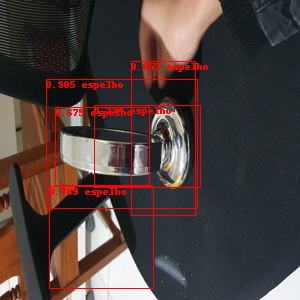

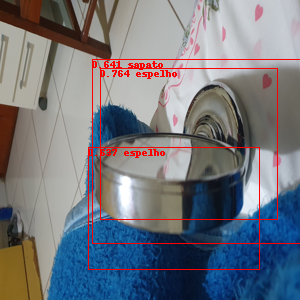

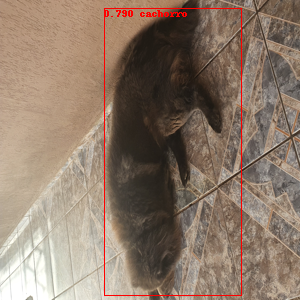

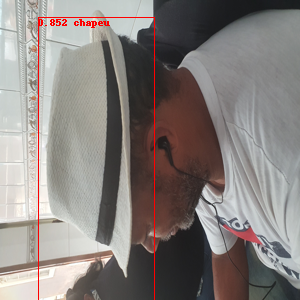

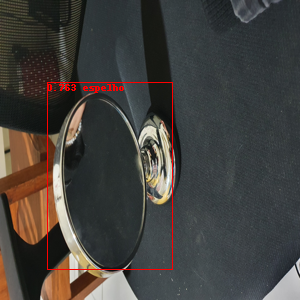

...

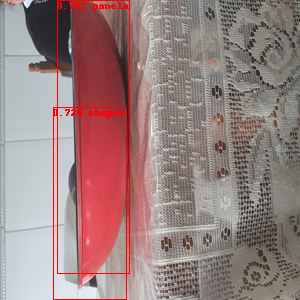

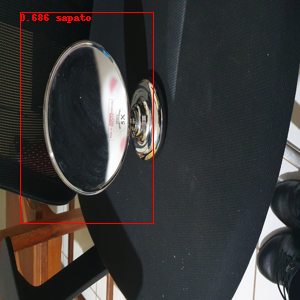

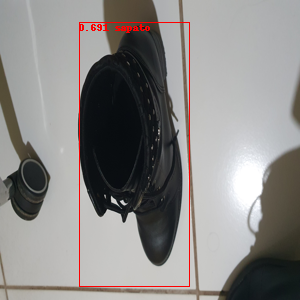

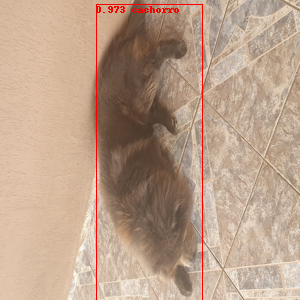

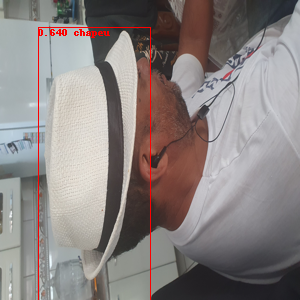

In [ ]:
model.eval()
for i in range(len(data)):
    img   = Image.open(data.data[i]['file_img']).convert("RGB")
    img = img.resize((300,300))
    w,h = img.size
    boxes = torch.tensor(data.data[i]['boxes'])
    timg,tboxes = transform_data(img,boxes)
    _,rw,rh = timg.shape
    sw = float(w)/rw
    sh = float(h)/rh
    with torch.no_grad():
        #timg2 = timg.view(1,3,300,300)
        timg.to(device)
        pred = model( timg.view(1,3,300,300))
        #pred = pred.cpu()
    boxes = pred[0]['boxes'] * torch.tensor([sw,sh,sw,sh])
    labels_id = pred[0]['labels']
    labels = [data.target_names[id] for id in labels_id]
    scores = pred[0]['scores']
    draw_boxes_all(img,boxes,labels,scores)